In [24]:
import numpy as np
import matplotlib.pyplot as plt
import casadi as ca
import scipy
import numpy as np
import matplotlib.pyplot as plt
import scipy 
from scipy.special import legendre,eval_legendre
import scipy.interpolate as interpolate
import scipy.special
import plotly.graph_objects as go

In [25]:
def lglnodes(N):

    N1 = N + 1
    x = np.cos(np.pi * np.arange(N1) / N)
    P = np.zeros((N1, N1))
    xold = 2 * np.ones_like(x)
    while np.max(np.abs(x - xold)) > np.finfo(float).eps:
        xold = x.copy()
        P[:, 0] = 1
        P[:, 1] = x
        for k in range(2, N1):
            P[:, k] = ((2 * k - 1) * x * P[:, k - 1] - (k - 1) * P[:, k - 2]) / k
        x = xold - (x * P[:, N] - P[:, N - 1]) / (N1 * P[:, N])
    w = 2 / (N * N1 * P[:, N]**2)
    return x, w


In [26]:
def D_matrix(nodes):
    n = len(nodes)
    wj = lambda j: 1/np.product(nodes[j]-np.delete(nodes,j,0))
    D = np.zeros((n,n))
    for i in range(n):
        for j in range(n):
            idxs = [m for m in range(len(nodes))]
            idxs.remove(j)
            D[i,j] = wj(j)* np.sum([np.product(nodes[i]-np.delete(nodes,[j,m])) for m in idxs])

    return D

In [27]:
x_grid, y_grid, z_grid = np.mgrid[0:10:30j, 0:10:30j, 0:5:30j]


def obstacle1(x, y, z):
    return (((x - 2) /2)**2 + ((y - 2) / 1)**2 )

def obstacle2(x, y, z):
    return (((x - 6) / 1)**2 + ((y - 1) / 1)**2 )

def obstacle3(x, y, z):
    return (((x - 8) / 1)**2 + ((y - 6) / 1)**2 )

def obstacle4(x, y, z):
    return (((x - 4) / 1.5)**2 + ((y - 6) / 1.5)**2 )


obs1 = obstacle1(x_grid, y_grid, z_grid)
obs2 = obstacle2(x_grid, y_grid, z_grid)
obs3 = obstacle3(x_grid, y_grid, z_grid)
obs4 = obstacle4(x_grid,y_grid,z_grid)

fig = go.Figure()
fig.add_trace(go.Volume(
    x=x_grid.flatten(), y=y_grid.flatten(), z=z_grid.flatten(),
    value=obs1.flatten().astype(float),
    isomin=0, isomax=1,
    opacity=0.5, surface_count=10,
    colorscale="Reds",showscale=False,
    name="Obstacle 1"
))
fig.add_trace(go.Volume(
    x=x_grid.flatten(), y=y_grid.flatten(), z=z_grid.flatten(),
    value=obs2.flatten().astype(float),
    isomin=0, isomax=1,
    opacity=0.7, surface_count=10,
    colorscale="Blues",showscale=False,
    name="Obstacle 2"
))
fig.add_trace(go.Volume(
    x=x_grid.flatten(), y=y_grid.flatten(), z=z_grid.flatten(),
    value=obs3.flatten().astype(float),
    isomin=0, isomax=1,
    opacity=0.7, surface_count=10,
    colorscale="Greens",showscale=False,
    name="Obstacle 3"
))
fig.add_trace(go.Volume(
    x=x_grid.flatten(), y=y_grid.flatten(), z=z_grid.flatten(),
    value=obs4.flatten().astype(float),
    isomin=0, isomax=1,
    opacity=0.7, surface_count=10,
    colorscale="oranges",showscale=False,
    name="Obstacle 4"
))
fig.show()

In [28]:
opti = ca.Opti()
N = 20  
nodes, weights = lglnodes(N)
D = D_matrix(nodes=nodes)


mass = 4.3 
V_max = 5
S_ref = 0.473 
gamma_max = np.pi / 4
xi_max = np.pi
CD0 = 0.02
CD1 = 0
CD2 = 0
CL_max = 1.1
T_max = 60
mu_max = np.pi/3

#Variables
x = opti.variable(N + 1)
y = opti.variable(N + 1)
z = opti.variable(N + 1)
V = opti.variable(N + 1)
gamma = opti.variable(N + 1)
xi = opti.variable(N + 1)
tf = opti.variable(1)
dh_dt = 2/tf * ca.mtimes(D,z)
dx_dt = 2/tf * ca.mtimes(D,x)
dy_dt = 2/tf * ca.mtimes(D,y)

dV_dt = 2/tf * ca.mtimes(D,V)
dxi_dt = 2/tf * ca.mtimes(D,xi)
dgamma_dt = 2/tf * ca.mtimes(D,gamma)
mu = ca.atan2(ca.cos(gamma)*dxi_dt,dgamma_dt+9.81*(ca.cos(gamma)/V))
CL = (mass*V*dgamma_dt+mass*9.81*ca.cos(gamma))/(0.5*1.225*S_ref*V**2*ca.cos(mu))
T = mass*dV_dt + (0.5*1.225*S_ref*V**2*(CD0+CD1*CL+CD2*CL**2))+mass*9.81*ca.sin(gamma)

# Initial and final conditions
opti.subject_to(x[0] == 0)
opti.subject_to(y[0] == 0)
opti.subject_to(z[0] == 0)
opti.subject_to(x[-1] == 10)
opti.subject_to(y[-1] == 10)
opti.subject_to(z[-1] == 5)

# Velocity constraint
opti.subject_to(opti.bounded(0, V, V_max))

# Dynamics constraints
scaling = tf / 2
opti.subject_to(scaling * V * ca.cos(gamma) * ca.cos(xi) == ca.mtimes(D, x))
opti.subject_to(scaling * V * ca.cos(gamma) * ca.sin(xi) == ca.mtimes(D, y))
opti.subject_to(scaling * V * ca.sin(gamma) == ca.mtimes(D, z))

# Bounds on angles
opti.subject_to(opti.bounded(-gamma_max, gamma, gamma_max))
opti.subject_to(opti.bounded(-xi_max, xi, xi_max))

# Obstacle avoidance constraints with soft constraint approach
def obstacle_soft_constraints(x, y, z):
    return ca.sumsqr(
        ca.fmax(0, 2 - obstacle1(x, y, z)) +
        ca.fmax(0, 2 - obstacle2(x, y, z)) +
        ca.fmax(0, 2 - obstacle3(x, y, z))+
        ca.fmax(0, 2 - obstacle4(x, y, z))
    )

def obstacle_soft_cons(x, y,z):
    return ca.sumsqr(((ca.exp(ca.exp(-obstacle1(x, y,z) + 2)) - 1) ** 4 +
                      (ca.exp(ca.exp(-obstacle2(x, y,z) + 2)) - 1) ** 4 +
                      (ca.exp(ca.exp(-obstacle3(x, y,z) + 2)) - 1) ** 4 +
                      (ca.exp(ca.exp(-obstacle4(x, y,z) + 2)) - 1) ** 4 ))**0.25

opti.minimize(tf**2 + 10 * obstacle_soft_constraints(x, y, z))



p_opts = {"expand": True}
s_opts = {
    "tol": 1e-3,
    "max_iter": 5000,
    "constr_viol_tol": 1e-2,
    "acceptable_constr_viol_tol": 1e-2,
}
opti.solver('ipopt', p_opts, s_opts)

# Initial guesses for states and final time
opti.set_initial(x, np.linspace(0, 10, N + 1))
opti.set_initial(y, np.linspace(0, 10, N + 1))
opti.set_initial(z, np.linspace(2.5, 1, N + 1))
opti.set_initial(V, V_max * 0.5)
opti.set_initial(gamma, 0)
opti.set_initial(xi, 0)
opti.set_initial(tf, 20)  


sol = opti.solve()

x_sol = sol.value(x)
y_sol = sol.value(y)
z_sol = sol.value(z)
tf_sol = sol.value(tf)

This is Ipopt version 3.14.11, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:     1560
Number of nonzeros in inequality constraint Jacobian.:       63
Number of nonzeros in Lagrangian Hessian.............:      232

Total number of variables............................:      127
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       69
Total number of inequality constraints...............:       63
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:       63
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  5.3733893e+02 6.50e+01 2.54e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00 

In [29]:
x_grid, y_grid, z_grid = np.mgrid[0:10:30j, 0:10:30j, 0:5:30j]


obs1 = obstacle1(x_grid, y_grid, z_grid)
obs2 = obstacle2(x_grid, y_grid, z_grid)
obs3 = obstacle3(x_grid, y_grid, z_grid)
obs4 = obstacle4(x_grid,y_grid,z_grid)

fig = go.Figure()


fig.add_trace(go.Scatter3d(
    x=x_sol, y=y_sol, z=z_sol,
    mode='lines+markers',
    marker=dict(size=4, color='blue'),
    line=dict(color='blue', width=3),
    name="UAV Path",
))


fig.add_trace(go.Volume(
    x=x_grid.flatten(), y=y_grid.flatten(), z=z_grid.flatten(),
    value=obs1.flatten().astype(float),
    isomin=0, isomax=1,
    opacity=0.5, surface_count=10,
    colorscale="Reds",
    name="Obstacle 1"
))

fig.add_trace(go.Volume(
    x=x_grid.flatten(), y=y_grid.flatten(), z=z_grid.flatten(),
    value=obs2.flatten().astype(float),
    isomin=0, isomax=1,
    opacity=0.7, surface_count=10,
    colorscale="Blues",
    name="Obstacle 2"
))

fig.add_trace(go.Volume(
    x=x_grid.flatten(), y=y_grid.flatten(), z=z_grid.flatten(),
    value=obs3.flatten().astype(float),
    isomin=0, isomax=1,
    opacity=0.7, surface_count=10,
    colorscale="Greens",
    name="Obstacle 3"
))

fig.add_trace(go.Volume(
    x=x_grid.flatten(), y=y_grid.flatten(), z=z_grid.flatten(),
    value=obs4.flatten().astype(float),
    isomin=0, isomax=1,
    opacity=0.7, surface_count=10,
    colorscale="oranges",
    name="Obstacle 4"
))

fig.update_layout(
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='Z'
    ),
    title="UAV Path with Obstacles",
    showlegend=True
)


# fig.write_html("uav_path_with_obstacles_3d2.html")
print("Interactive 3D path plot with obstacles saved as 'uav_path_with_obstacles_3d.html'")
fig.show()

Interactive 3D path plot with obstacles saved as 'uav_path_with_obstacles_3d.html'


In [30]:
time_points = (tf_sol/2*(nodes+1))
V_sol = sol.value(V)
T_sol = sol.value(T)
CL_sol = sol.value(CL)
gamma_sol = sol.value(gamma)
xi_sol = sol.value(xi)
mu_sol = sol.value(mu)

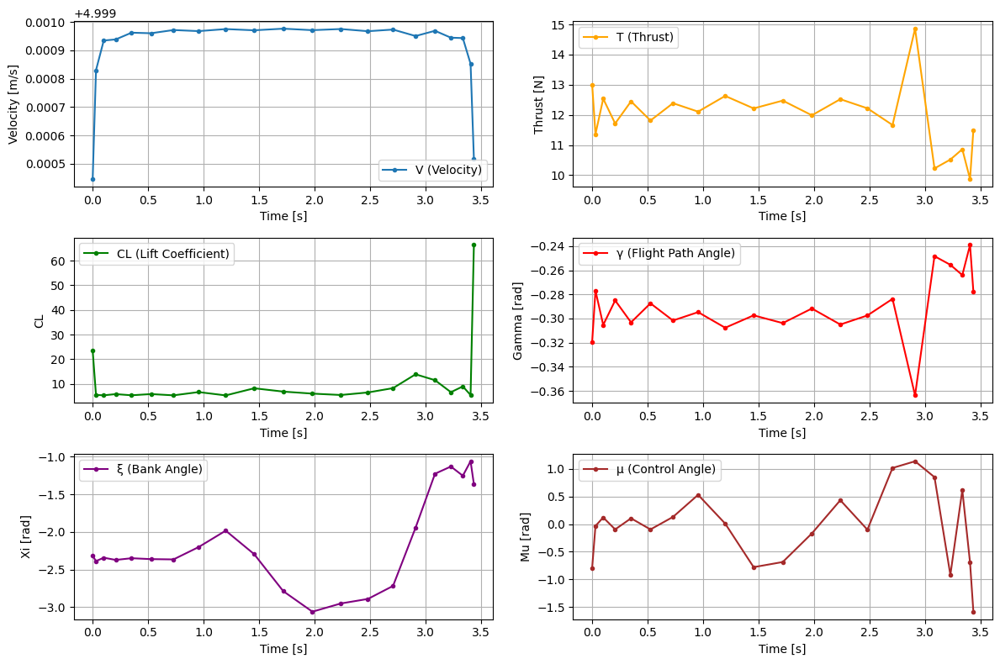

In [31]:

plt.figure(figsize=(12, 8))
# Velocity V
plt.subplot(3, 2, 1)
plt.plot(time_points, V_sol,'.-', label="V (Velocity)")
plt.xlabel("Time [s]")
plt.ylabel("Velocity [m/s]")
plt.grid()
plt.legend()

# Thrust T
plt.subplot(3, 2, 2)
plt.plot(time_points, -T_sol,'.-', label="T (Thrust)", color='orange')
plt.xlabel("Time [s]")
plt.ylabel("Thrust [N]")
plt.grid()
plt.legend()

# Lift Coefficient CL
plt.subplot(3, 2, 3)
plt.plot(time_points, CL_sol,'.-', label="CL (Lift Coefficient)", color='green')
plt.xlabel("Time [s]")
plt.ylabel("CL")
plt.grid()
plt.legend()

# Flight Path Angle gamma
plt.subplot(3, 2, 4)
plt.plot(time_points, gamma_sol,'.-', label="γ (Flight Path Angle)", color='red')
plt.xlabel("Time [s]")
plt.ylabel("Gamma [rad]")
plt.grid()
plt.legend()

# Bank Angle xi
plt.subplot(3, 2, 5)
plt.plot(time_points, xi_sol,'.-', label="ξ (Bank Angle)", color='purple')
plt.xlabel("Time [s]")
plt.ylabel("Xi [rad]")
plt.grid()
plt.legend()

# Control Angle mu
plt.subplot(3, 2, 6)
plt.plot(time_points, mu_sol,'.-', label="μ (Control Angle)", color='brown')
plt.xlabel("Time [s]")
plt.ylabel("Mu [rad]")
plt.grid()
plt.legend()

plt.tight_layout()
plt.show()